# CIND 820 Traffic Collision Data Analysis and Prediction
### Initial Results and Code



---


**Table of Contents**

1.   Data Import and Description
2.   Data Preprocessing
3.   Exploratory Data Analysis
4.   Feature Engineering and Algorithm Exploration
5.   Hotspot Visualization using Apriori
6.   Collision Prediction using Logistic Regression
7.   Collision Prediction using Random Forest
8.   Decision Tree
8.   Comparison and Results
8.   Conclusion



## Dataset Overview
- **Source:** https://open.ottawa.ca/datasets/ottawa::traffic-collision-data/about
- **Size:** 74,613 rows, 29 columns
- **Date Range:** 2017-2023
- **Format:** CSV
- **Copyright:** Open Data Licence Version 2.0 (worldwide, royalty-free, perpetual, non-exclusive licence to copy, modify, publish, translate, adapt and distribute

## Goal of project
- **Use Case:** Predicting Traffic Collision
- **Industry:** Transportation Safety and Traffic management
-  **Users:** City planners, Law enforcement, General public, Cyclists
- **Result:** Develop an application that can predict collision probability from a user input location or a planned route (tentative).

## Questions

These are some of the questions we will be investigating during this project

*  What are the locations where the most frequent accidents occur?
*  Do weather and environmental conditions affect traffic collisions?
*  Do traffic measures decrease traffic collisions?

In [11]:
%reset -f

In [12]:
# Packages to install
# mlxtend for apriori
# Y-data-profiling for eda report

%%capture

!pip install pandas mlxtend -q
!pip install ydata-profiling -q
!pip install pandas folium -q
!pip install scikit-learn --upgrade -q

# Section 1. Data Import and Description

---



In [18]:
# Import Libraries and load the dataset
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import timedelta
%matplotlib inline

pd.pandas.set_option('display.max_columns', None)
data=pd.read_csv("Traffic_Collision_Data.csv")
data.head()

In [20]:
# Print a summary of the data attributes
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 74612 entries, 0 to 74611
Data columns (total 30 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   X                           74612 non-null  float64
 1   Y                           74612 non-null  float64
 2   ID                          74612 non-null  object 
 3   Geo_ID                      74612 non-null  object 
 4   Accident_Year               0 non-null      float64
 5   Accident_Date               74612 non-null  object 
 6   Accident_Time               74612 non-null  object 
 7   Location                    74612 non-null  object 
 8   Location_Type               74612 non-null  object 
 9   Classification_Of_Accident  74612 non-null  object 
 10  Initial_Impact_Type         74607 non-null  object 
 11  Road_Surface_Condition      74611 non-null  object 
 12  Environment_Condition       74610 non-null  object 
 13  Light                       746

In [21]:
# Show the descriptive statistics
data.describe()

,X,Y,Accident_Year,Num_of_Vehicle,Num_Of_Pedestrians,Num_of_Bicycles,Num_of_Motorcycles,Num_of_Injuries,Num_of_Minimal_Injuries,Num_of_Minor_Injuries,Num_of_Major_Injuries,Num_of_Fatal_Injuries,X_Coordinate,Y_Coordinate,Lat,Long,ObjectId
count,7.461200e+04,7.461200e+04,0.0,74612.000000,74612.000000,1347.000000,637.000000,13417.000000,5733.000000,7804.000000,671.000000,141.000000,74612.000000,7.461200e+04,74612.000000,74612.000000,74612.000000
mean,-8.428035e+06,5.670130e+06,NaN,1.841219,0.022289,1.010393,1.015699,1.298353,1.212977,1.226422,1.108793,1.070922,366572.012158,5.017227e+06,45.291930,-75.710325,37306.500000
std,1.870145e+04,2.316663e+05,NaN,0.586512,0.153846,0.115173,0.136459,0.734951,0.562083,0.585715,0.612139,0.283987,15213.451923,2.042363e+05,1.843572,0.167998,21538.773479
min,-8.820655e+06,0.000000e+00,NaN,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000e+00,0.000000,-79.237290,1.000000
25%,-8.433028e+06,5.674170e+06,NaN,2.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,363147.689000,5.021766e+06,45.333451,-75.755176,18653.750000
50%,-8.426515e+06,5.681383e+06,NaN,2.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,367676.548050,5.026853e+06,45.378984,-75.696671,37306.500000
75%,-8.420483e+06,5.687619e+06,NaN,2.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,371925.281000,5.031266e+06,45.418314,-75.642484,55959.250000
max,-8.378081e+06,5.704542e+06,NaN,25.000000,3.000000,3.000000,3.000000,38.000000,11.000000,10.000000,14.000000,3.000000,401821.931000,5.043439e+06,45.524921,-75.261583,74612.000000


In [29]:
# Check for missing values
print("Missing Values:")
print(data.isnull().sum())

Missing Values:
X                                 0
Y                                 0
ID                                0
Geo_ID                            0
Accident_Year                 74612
Accident_Date                     0
Accident_Time                     0
Location                          0
Location_Type                     0
Classification_Of_Accident        0
Initial_Impact_Type               5
Road_Surface_Condition            1
Environment_Condition             2
Light                             0
Traffic_Control                   1
Num_of_Vehicle                    0
Num_Of_Pedestrians                0
Num_of_Bicycles               73265
Num_of_Motorcycles            73975
Max_Injury                    61143
Num_of_Injuries               61195
Num_of_Minimal_Injuries       68879
Num_of_Minor_Injuries         66808
Num_of_Major_Injuries         73941
Num_of_Fatal_Injuries         74471
X_Coordinate                      0
Y_Coordinate                      0
Lat         

**Summary of Data Description**

*  Accident_Year has 100% missing values                 
*  These attributes all have >80% missing values:
   * Num_of_Bicycles, Num_of_Motorcycles, Max_Injury, Num_of_Injuries, Num_of_Minimal_Injuries, Num_of_Minor_Injuries, Num_of_Major_Injuries, Num_of_Fatal_Injuries
* These have < 5 missing values
  * Traffic_Control, Initial_Impact_Type, Road_Surface_Condition, environmental condition
*  The column Accident_Time contains some "Unknown" or Null values
*  Accident_Date and Accident_Time should be combined
*  X, Y, GeoID, X_Cordinate, Y_Coordinate are duplicates and not needed
*  ID, GEOID are metadata
*  Classification_Of_Accident, etc contains numbers corresponding categorical data



# Section 2. Data Cleaning and Preprocessing

---
* Remove "unknown" from accident_time and combine the time columns
* Clean data inside some categorical columns
* Drop unnecessary columns
* Replace null values with zero in injury.

In [81]:
# Remove Unknown values from te Accident_Time and replace with median

df = data.copy()

# This fixes "Unknown" values in the Accident_Time column by replacing them with a median time
df['Accident_Time1'] = pd.to_datetime(df['Accident_Time'], errors='coerce', format='%H:%M')
median_time = df['Accident_Time1'].dropna().median()
if pd.notnull(median_time):
    median_time_str = median_time.strftime('%H:%M')

df['Accident_Time'] = df['Accident_Time'].replace("Unknown", median_time_str)
df.head(1)


,X,Y,ID,Geo_ID,Accident_Year,Accident_Date,Accident_Time,Location,Location_Type,Classification_Of_Accident,Initial_Impact_Type,Road_Surface_Condition,Environment_Condition,Light,Traffic_Control,Num_of_Vehicle,Num_Of_Pedestrians,Num_of_Bicycles,Num_of_Motorcycles,Max_Injury,Num_of_Injuries,Num_of_Minimal_Injuries,Num_of_Minor_Injuries,Num_of_Major_Injuries,Num_of_Fatal_Injuries,X_Coordinate,Y_Coordinate,Lat,Long,ObjectId,Accident_Time1
0,-8.452607e+06,5.661674e+06,2017--1,__5RG32N,NaN,2017/01/01,1:28,WEST RIDGE DR btwn PARLOR PL & BERT G. ARGUE D...,Midblock,03 - P.D. only,07 - SMV other,03 - Loose snow,02 - Rain,07 - Dark,10 - No control,1,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,349455.5394,5012882.095,45.254481,-75.931061,1,1900-01-01 01:28:00


In [82]:
# Standardize the date and time by combining them
def combine_date_time(row):
    try:
        return pd.to_datetime(f"{row['Accident_Date']} {row['Accident_Time']}")
    except Exception:
        return pd.NaT

df['Accident_Timestamp'] = df.apply(combine_date_time, axis=1)
df.head(1)

,X,Y,ID,Geo_ID,Accident_Year,Accident_Date,Accident_Time,Location,Location_Type,Classification_Of_Accident,Initial_Impact_Type,Road_Surface_Condition,Environment_Condition,Light,Traffic_Control,Num_of_Vehicle,Num_Of_Pedestrians,Num_of_Bicycles,Num_of_Motorcycles,Max_Injury,Num_of_Injuries,Num_of_Minimal_Injuries,Num_of_Minor_Injuries,Num_of_Major_Injuries,Num_of_Fatal_Injuries,X_Coordinate,Y_Coordinate,Lat,Long,ObjectId,Accident_Time1,Accident_Timestamp
0,-8.452607e+06,5.661674e+06,2017--1,__5RG32N,NaN,2017/01/01,1:28,WEST RIDGE DR btwn PARLOR PL & BERT G. ARGUE D...,Midblock,03 - P.D. only,07 - SMV other,03 - Loose snow,02 - Rain,07 - Dark,10 - No control,1,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,349455.5394,5012882.095,45.254481,-75.931061,1,1900-01-01 01:28:00,2017-01-01 01:28:00


In [83]:
# Clean data inside category columns

df['Classification_Of_Accident'] = df['Classification_Of_Accident'].str.replace(r'^\d+\s*-\s*', '', regex=True)
df['Initial_Impact_Type'] = df['Initial_Impact_Type'].str.replace(r'^\d+\s*-\s*', '', regex=True)
df['Road_Surface_Condition'] = df['Road_Surface_Condition'].str.replace(r'^\d+\s*-\s*', '', regex=True)
df['Environment_Condition'] = df['Environment_Condition'].str.replace(r'^\d+\s*-\s*', '', regex=True)
df['Light'] = df['Light'].str.replace(r'^\d+\s*-\s*', '', regex=True)
df['Traffic_Control'] = df['Traffic_Control'].str.replace(r'^\d+\s*-\s*', '', regex=True)
df['Max_Injury'] = df['Max_Injury'].str.replace(r'^\d+\s*-\s*', '', regex=True)
df.head(1)

,X,Y,ID,Geo_ID,Accident_Year,Accident_Date,Accident_Time,Location,Location_Type,Classification_Of_Accident,Initial_Impact_Type,Road_Surface_Condition,Environment_Condition,Light,Traffic_Control,Num_of_Vehicle,Num_Of_Pedestrians,Num_of_Bicycles,Num_of_Motorcycles,Max_Injury,Num_of_Injuries,Num_of_Minimal_Injuries,Num_of_Minor_Injuries,Num_of_Major_Injuries,Num_of_Fatal_Injuries,X_Coordinate,Y_Coordinate,Lat,Long,ObjectId,Accident_Time1,Accident_Timestamp
0,-8.452607e+06,5.661674e+06,2017--1,__5RG32N,NaN,2017/01/01,1:28,WEST RIDGE DR btwn PARLOR PL & BERT G. ARGUE D...,Midblock,P.D. only,SMV other,Loose snow,Rain,Dark,No control,1,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,349455.5394,5012882.095,45.254481,-75.931061,1,1900-01-01 01:28:00,2017-01-01 01:28:00


In [84]:
# Step 2: Drop Redundant Columns

# Accident_Year contains only null values, Accident_Date, Accident_time have been combined
# ObjectID, Geo_ID, ID are database primary keys
# X_Coordinate, Y_Coordinate, X , Y are duplicates of long, lat
# Location column is irrelevant as lat and long are going to be used in this project
# Num_of_Minimal_Injuries, Num_of_Minor_Injuries, Num_of_Major_Injuries are not required as we will use num_of_injuries and fatal injuries

columns_to_drop = [
    "Geo_ID", "Accident_Year", "Accident_Date", "Accident_Time",
    "Accident_Time1", "X", "Y", "ObjectId", "ID",
    "X_Coordinate", "Y_Coordinate", "Location",
    "Num_of_Minimal_Injuries", "Num_of_Minor_Injuries",
    "Num_of_Major_Injuries"
]
df = df.drop(columns=columns_to_drop)
df.head()


,Location_Type,Classification_Of_Accident,Initial_Impact_Type,Road_Surface_Condition,Environment_Condition,Light,Traffic_Control,Num_of_Vehicle,Num_Of_Pedestrians,Num_of_Bicycles,Num_of_Motorcycles,Max_Injury,Num_of_Injuries,Num_of_Fatal_Injuries,Lat,Long,Accident_Timestamp
0,Midblock,P.D. only,SMV other,Loose snow,Rain,Dark,No control,1,0,NaN,NaN,NaN,NaN,NaN,45.254481,-75.931061,2017-01-01 01:28:00
1,Midblock,P.D. only,Sideswipe,Loose snow,Snow,Dark,No control,2,0,NaN,NaN,NaN,NaN,NaN,45.428323,-75.663225,2017-01-01 03:16:00
2,Intersection,P.D. only,SMV other,Dry,Drifting Snow,Dawn,Traffic signal,1,0,NaN,NaN,NaN,NaN,NaN,45.324735,-75.826700,2017-01-01 07:17:00
3,Intersection,P.D. only,Rear end,Loose snow,Snow,Daylight,Traffic signal,2,0,NaN,NaN,NaN,NaN,NaN,45.338011,-75.725984,2017-01-01 08:58:00
4,Intersection,P.D. only,Other,Wet,Clear,Daylight,Traffic signal,2,0,NaN,NaN,NaN,NaN,NaN,45.383786,-75.671842,2017-01-01 11:41:00


In [85]:
# Step 3: Fix missing Values and duplicates

# These columns contain mostly NA, fill them with zero
columns_to_fill = [
    'Num_of_Bicycles',
    'Num_of_Motorcycles',
    'Num_of_Injuries',
    'Num_of_Fatal_Injuries'
]
for column in columns_to_fill:
    df[column] = df[column].fillna(0)

# Fill missing values for the columns that have a low amount of missing values
for col in ['Initial_Impact_Type', 'Road_Surface_Condition', 'Environment_Condition', 'Traffic_Control']:
    mode_value = df[col].mode()
    if not mode_value.empty:  # Ensure mode is not empty
        df[col] = df[col].fillna(mode_value[0])

df.head()

,Location_Type,Classification_Of_Accident,Initial_Impact_Type,Road_Surface_Condition,Environment_Condition,Light,Traffic_Control,Num_of_Vehicle,Num_Of_Pedestrians,Num_of_Bicycles,Num_of_Motorcycles,Max_Injury,Num_of_Injuries,Num_of_Fatal_Injuries,Lat,Long,Accident_Timestamp
0,Midblock,P.D. only,SMV other,Loose snow,Rain,Dark,No control,1,0,0.0,0.0,NaN,0.0,0.0,45.254481,-75.931061,2017-01-01 01:28:00
1,Midblock,P.D. only,Sideswipe,Loose snow,Snow,Dark,No control,2,0,0.0,0.0,NaN,0.0,0.0,45.428323,-75.663225,2017-01-01 03:16:00
2,Intersection,P.D. only,SMV other,Dry,Drifting Snow,Dawn,Traffic signal,1,0,0.0,0.0,NaN,0.0,0.0,45.324735,-75.826700,2017-01-01 07:17:00
3,Intersection,P.D. only,Rear end,Loose snow,Snow,Daylight,Traffic signal,2,0,0.0,0.0,NaN,0.0,0.0,45.338011,-75.725984,2017-01-01 08:58:00
4,Intersection,P.D. only,Other,Wet,Clear,Daylight,Traffic signal,2,0,0.0,0.0,NaN,0.0,0.0,45.383786,-75.671842,2017-01-01 11:41:00


In [87]:
# Max_Injury (Categorical) - null values means no injury sustained will be filled with None

df['Max_Injury'] = df['Max_Injury'].fillna("None")

In [88]:
# Check if there are any missing values remaining
print(df.isnull().sum())

Location_Type                 0
Classification_Of_Accident    0
Initial_Impact_Type           0
Road_Surface_Condition        0
Environment_Condition         0
Light                         0
Traffic_Control               0
Num_of_Vehicle                0
Num_Of_Pedestrians            0
Num_of_Bicycles               0
Num_of_Motorcycles            0
Max_Injury                    0
Num_of_Injuries               0
Num_of_Fatal_Injuries         0
Lat                           0
Long                          0
Accident_Timestamp            0
dtype: int64


In [91]:
# Drop duplicates
Num_of_duplicates = sum(df.duplicated())
df = df.drop_duplicates()
print("Duplicates rows dropped:\n", Num_of_duplicates)

Duplicates rows dropped:
 0


In [92]:
# Standardize column names
# Some column names have missing 's' and wrong capital letters

df.rename(columns={'Num_of_Vehicle': 'Num_of_Vehicles'}, inplace=True)
df.rename(columns={'Num_Of_Pedestrians': 'Num_of_Pedestrians'}, inplace=True)
df.rename(columns={'Max_Injury': 'Injury_Type'}, inplace=True)
df.head(1)

,Location_Type,Classification_Of_Accident,Initial_Impact_Type,Road_Surface_Condition,Environment_Condition,Light,Traffic_Control,Num_of_Vehicles,Num_of_Pedestrians,Num_of_Bicycles,Num_of_Motorcycles,Injury_Type,Num_of_Injuries,Num_of_Fatal_Injuries,Lat,Long,Accident_Timestamp
0,Midblock,P.D. only,SMV other,Loose snow,Rain,Dark,No control,1,0,0.0,0.0,None,0.0,0.0,45.254481,-75.931061,2017-01-01 01:28:00


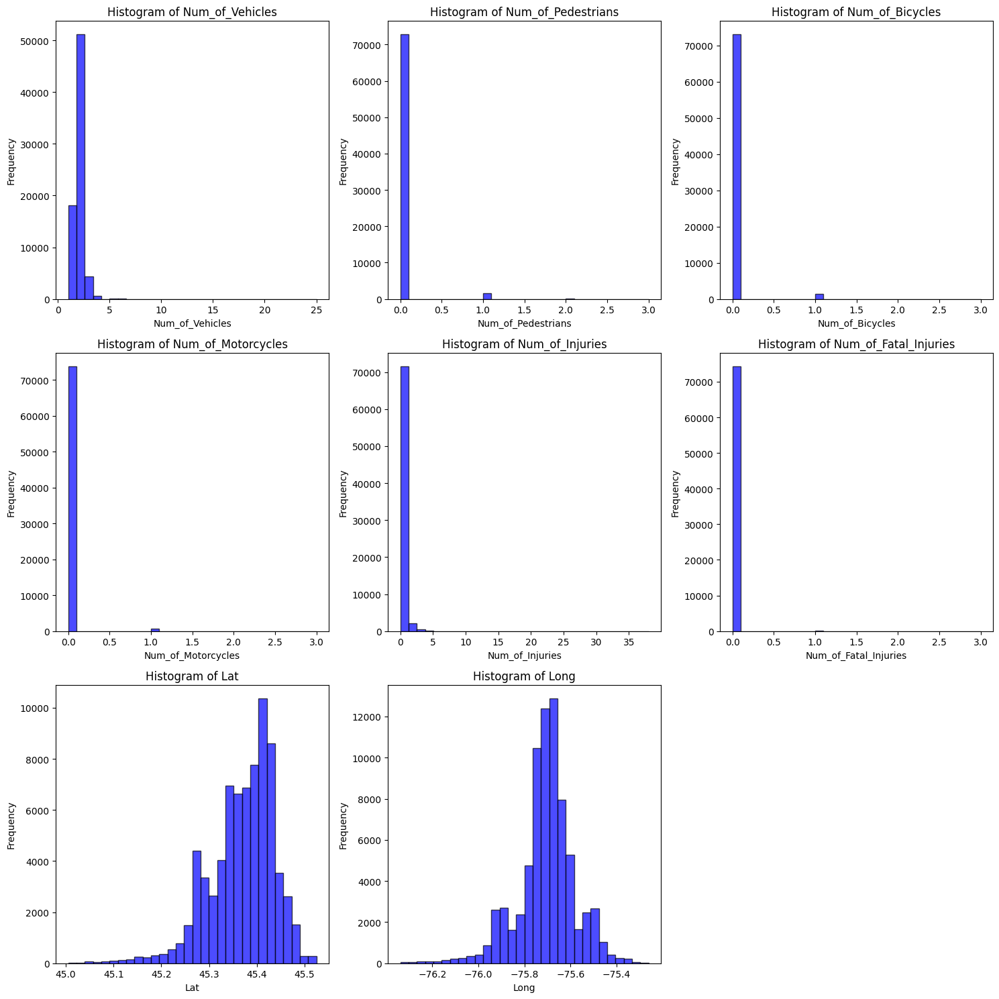

In [107]:
# Step 4: Check for Outliers
# There does not seem to be too many outliers

def plot_histograms(df):
    numerical_columns = df.select_dtypes(include=['number']).columns
    num_cols = len(numerical_columns)
    n_rows = (num_cols // 3) + (1 if num_cols % 3 != 0 else 0)  # 3 columns per row
    plt.figure(figsize=(15, 5 * n_rows))

    for i, column in enumerate(numerical_columns):
        plt.subplot(n_rows, 3, i + 1)
        plt.hist(df[column], bins=30, alpha=0.7, color='blue', edgecolor='black')
        plt.title(f'Histogram of {column}')
        plt.xlabel(column)
        plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

# Example usage
plot_histograms(df)


# num_cols = df.select_dtypes(include=['float64', 'int64']).columns
# df[num_cols].hist(bins=15, figsize=(15, 10), layout=(3, 3))
# plt.suptitle('Histograms of Numerical attributes')
# plt.tight_layout()
# plt.show()



In [95]:
# Remove outliers inside the lat and long

# Approximate range for Ottawa, Canada
lat_min, lat_max = 45.0, 46.0
long_min, long_max = -76.5, -75.0

new_df = df[(df['Lat'] >= lat_min) & (df['Lat'] <= lat_max) &
                     (df['Long'] >= long_min) & (df['Long'] <= long_max)]

removed_count = len(df) - len(new_df)
df = new_df.copy()

print(str(removed_count) + " out of bound longitudes and latitues have been removed")

0 out of bound longitudes and latitues have been removed


In [100]:
# Step 5: One Hot Encode on whole data set

columns_to_encode = [
    'Location_Type', 'Classification_Of_Accident', 'Initial_Impact_Type',
    'Road_Surface_Condition', 'Environment_Condition', 'Light',
    'Traffic_Control', 'Injury_Type'
]

# Ensure the columns to be encoded are treated as strings
for col in columns_to_encode:
    df[col] = df[col].astype(str)

# Perform one-hot encoding
encoded_data = pd.get_dummies(df, columns=columns_to_encode, drop_first=True)

# Display the resulting dataset's shape to confirm encoding
print("Original dataset shape:", df.shape)
print("Encoded dataset shape:", encoded_data.shape)
df = encoded_data.copy()
df.head(1)

Original dataset shape: (74444, 17)
Encoded dataset shape: (74444, 57)


,Num_of_Vehicles,Num_of_Pedestrians,Num_of_Bicycles,Num_of_Motorcycles,Num_of_Injuries,Num_of_Fatal_Injuries,Lat,Long,Accident_Timestamp,Location_Type_Midblock,Classification_Of_Accident_Non-fatal injury,Classification_Of_Accident_P.D. only,Initial_Impact_Type_Approaching,Initial_Impact_Type_Other,Initial_Impact_Type_Rear end,Initial_Impact_Type_SMV other,Initial_Impact_Type_SMV unattended vehicle,Initial_Impact_Type_Sideswipe,Initial_Impact_Type_Turning movement,Road_Surface_Condition_Ice,Road_Surface_Condition_Loose sand or gravel,Road_Surface_Condition_Loose snow,Road_Surface_Condition_Mud,Road_Surface_Condition_Other,Road_Surface_Condition_Packed snow,Road_Surface_Condition_Slush,Road_Surface_Condition_Spilled liquid,Road_Surface_Condition_Unknown,Road_Surface_Condition_Wet,Environment_Condition_Drifting Snow,"Environment_Condition_Fog, mist, smoke, dust",Environment_Condition_Freezing Rain,Environment_Condition_Other,Environment_Condition_Rain,Environment_Condition_Snow,Environment_Condition_Strong wind,Environment_Condition_Unknown,Light_Dawn,Light_Daylight,Light_Dusk,Light_Other,Light_Unknown,Traffic_Control_MPS,Traffic_Control_No control,Traffic_Control_Other,Traffic_Control_Ped. crossover,Traffic_Control_Roundabout,Traffic_Control_School bus,Traffic_Control_Stop sign,Traffic_Control_Traffic controller,Traffic_Control_Traffic gate,Traffic_Control_Traffic signal,Traffic_Control_Yield sign,Injury_Type_Major,Injury_Type_Minimal,Injury_Type_Minor,Injury_Type_None
0,1,0,0.0,0.0,0.0,0.0,45.254481,-75.931061,2017-01-01 01:28:00,True,False,True,False,False,False,True,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,True


In [101]:
df.to_csv('clean_df.csv', index=False)

**Summary of Data preprocessing**

* Column that have greater greater than 80% null values have been replaced by zero because they are number of injuries
* Columns that have less than 5 null were replaced by median
* Several Columns have been dropped
* Longitudes and latitudes that were out of bounds have been removed
* Time and Date columns have been combined
* Duplicates have been removed
* Categorical columns have been one hot encoded

# Section 3.   Exploratory Data Analysis and Visualization
---





In [ ]:
from ydata_profiling import ProfileReport
profile = ProfileReport(df, title="Traffic Collision Report")
profile.to_file("collision_report.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

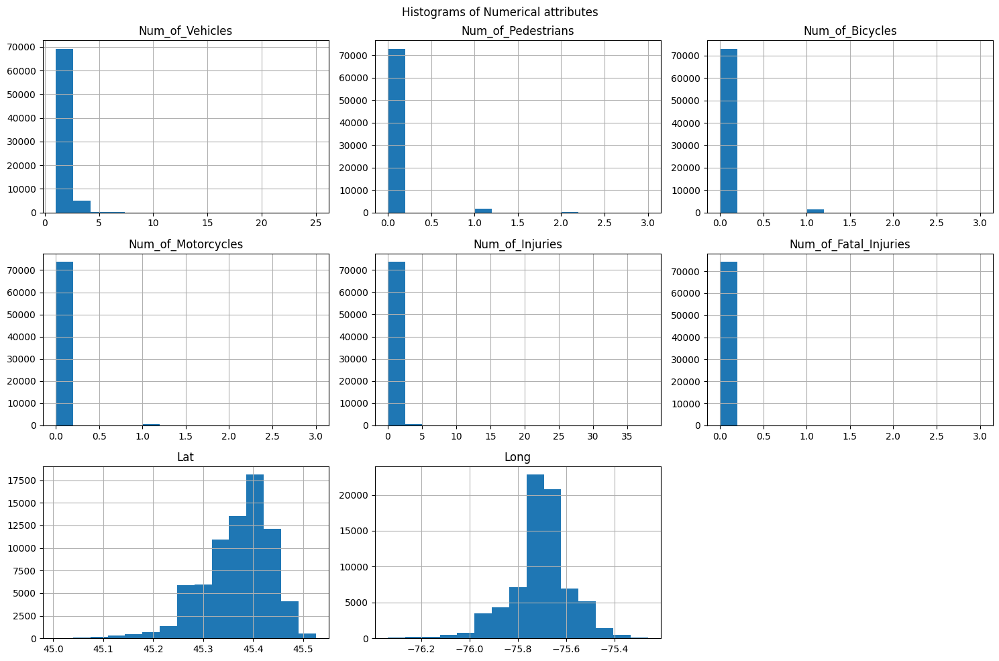

In [105]:
# Histograms for numerical attributes

num_cols = df.select_dtypes(include=['float64', 'int64']).columns
df[num_cols].hist(bins=15, figsize=(15, 10), layout=(3, 3))
plt.suptitle('Histograms of Numerical attributes')
plt.tight_layout()
plt.show()


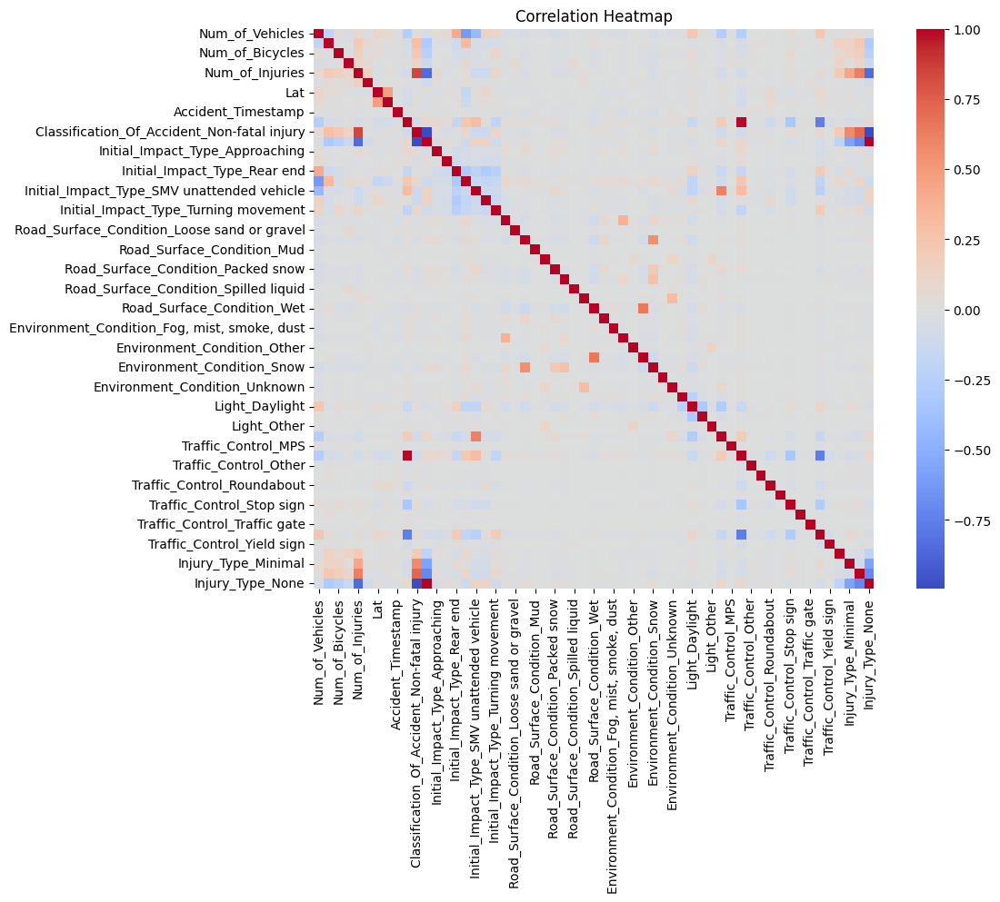

In [109]:
# Correlation Heatmap

plt.figure(figsize=(12, 8))
correlation_matrix = df.corr()
sns.heatmap(correlation_matrix, annot=False, fmt='.2f', cmap='coolwarm', square=True)
plt.title('Correlation Heatmap')
plt.show()

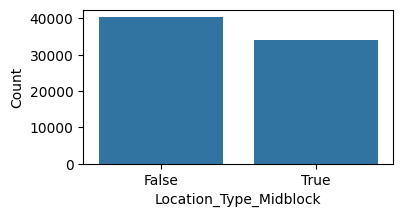

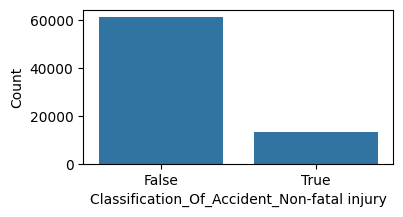

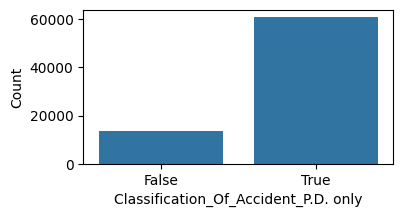

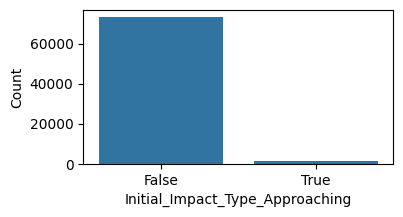

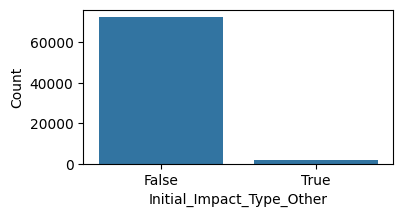

...

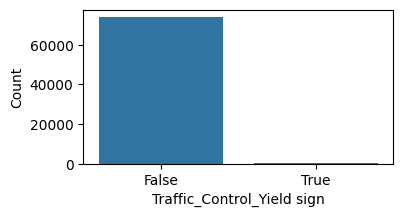

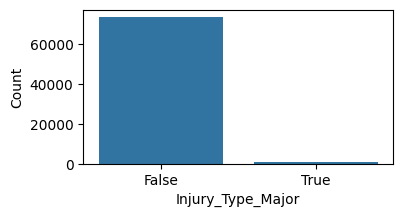

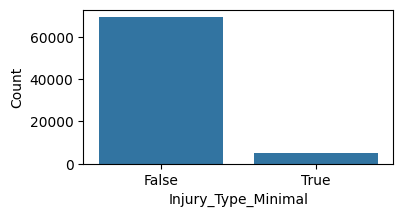

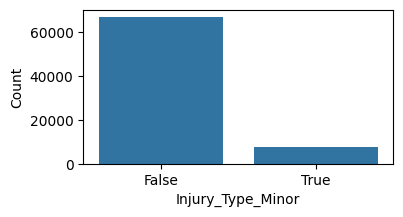

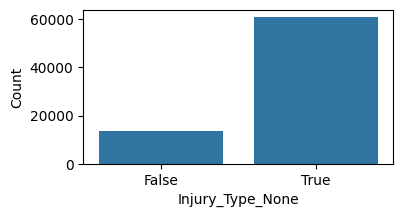

In [129]:
# Count plots for categorical variables
categorical_cols = df.select_dtypes(include=['bool']).columns

for col in categorical_cols:
    plt.figure(figsize=(4, 2))
    sns.countplot(x=col, data=df)
    plt.xlabel(col)
    plt.ylabel('Count')
    plt.show()

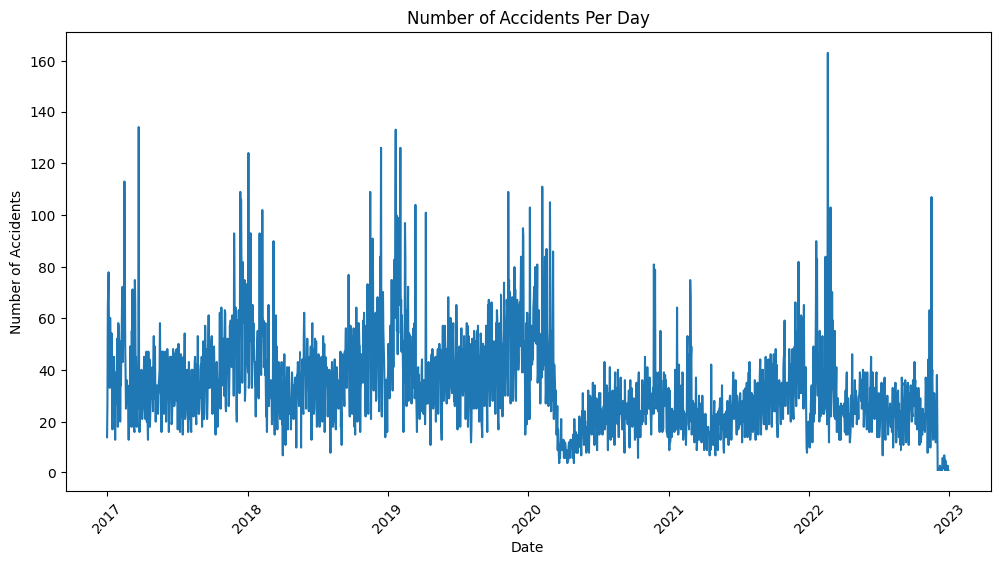

In [137]:
# Count of accidents per day
plt.figure(figsize=(12, 6))
daily_counts = df['Date'].value_counts().sort_index()
sns.lineplot(x=daily_counts.index, y=daily_counts.values)
plt.xticks(rotation=45)
plt.title('Number of Accidents Per Day')
plt.xlabel('Date')
plt.ylabel('Number of Accidents')
plt.show()


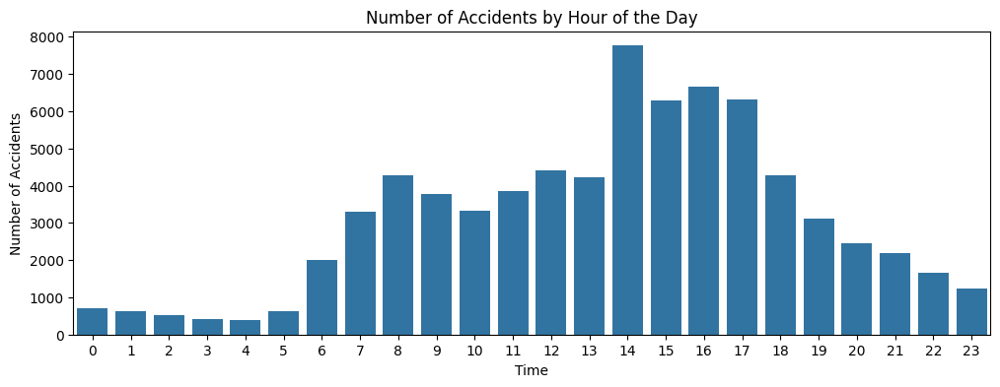

In [138]:
# Count of accidents by hour
plt.figure(figsize=(12, 4))
hourly_counts = df['Hour'].value_counts().sort_index()
sns.barplot(x=hourly_counts.index, y=hourly_counts.values)
plt.title('Number of Accidents by Hour of the Day')
plt.xlabel('Time')
plt.ylabel('Number of Accidents')
plt.show()

In [140]:
import pandas as pd
import folium

def create_map(df, lat_column, lon_column, value_column=None):
    m = folium.Map(location=[df[lat_column].mean(), df[lon_column].mean()], zoom_start=12)

    for _, row in df.iterrows():
      if row[value_column] > 0:
        popup_text = f'{value_column}: {row[value_column]}' if value_column else None
        folium.CircleMarker(
            location=(row[lat_column], row[lon_column]),
            radius=1,
            color='red',
            fill=True,
            fill_color='red',
            fill_opacity=0.5,
            popup=popup_text
        ).add_to(m)

    return m

lat_column = 'Lat'
lon_column = 'Long'
value_column = 'Num_of_Injuries'

# Create the map
map_with_dots = create_map(df, lat_column, lon_column, value_column)

map_with_dots

# Save the map to an HTML file
# map_with_dots.save('map_with_dots.html')

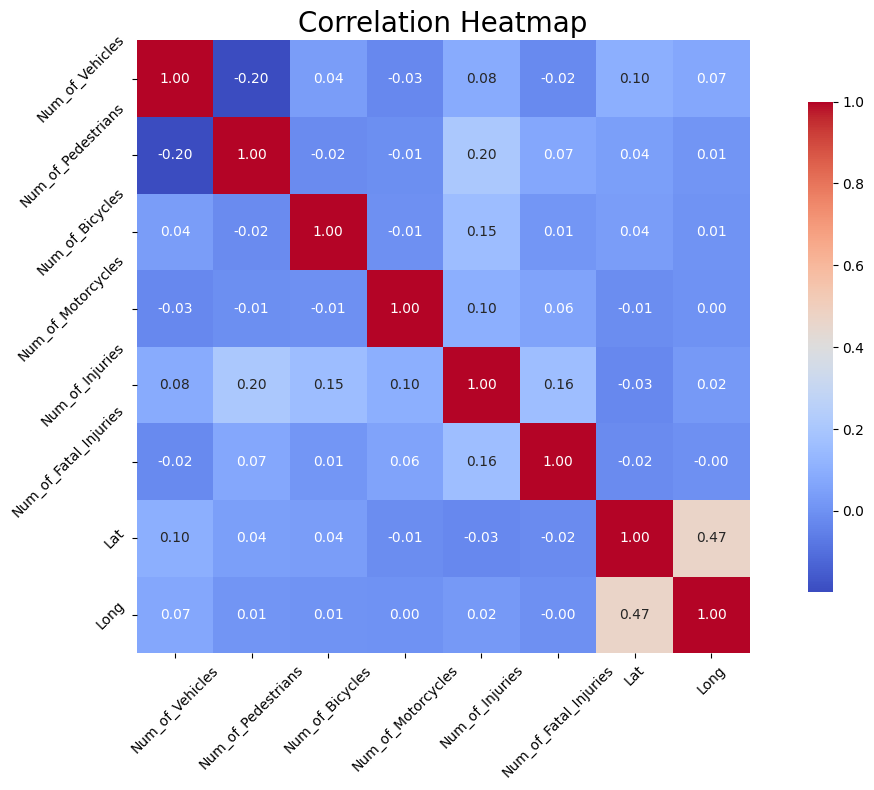

In [144]:

# Convert 'Accident_Timestamp' to datetime if not already done
data['Accident_Timestamp'] = pd.to_datetime(df['Accident_Timestamp'])

# Drop non-numeric columns for correlation analysis
numeric_data = df.select_dtypes(include=['float64', 'int64'])

# Calculate the correlation matrix
correlation_matrix = numeric_data.corr()

# Set up the matplotlib figure
plt.figure(figsize=(12, 8))

# Create a heatmap
sns.heatmap(correlation_matrix, annot=True, fmt='.2f', cmap='coolwarm', square=True, cbar_kws={"shrink": .8})

# Title and labels
plt.title('Correlation Heatmap', size=20)
plt.xticks(rotation=45)
plt.yticks(rotation=45)
plt.tight_layout()

# Show the plot
plt.show()

# Section 4. Visualize the hotspots using Apriori
---


In [ ]:
df.head()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,Location_Type,Classification_Of_Accident,Initial_Impact_Type,Road_Surface_Condition,Environment_Condition,Light,Traffic_Control,Num_of_Vehicle,Num_Of_Pedestrians,Num_of_Bicycles,Num_of_Motorcycles,Max_Injury,Num_of_Injuries,Num_of_Minimal_Injuries,Num_of_Minor_Injuries,Num_of_Major_Injuries,Num_of_Fatal_Injuries,Lat,Long,Accident_Timestamp
0,Midblock,P.D. only,SMV other,Loose snow,Rain,Dark,No control,1,0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,45.254481,-75.931061,2017-01-01 01:28:00
1,Midblock,P.D. only,Sideswipe,Loose snow,Snow,Dark,No control,2,0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,45.428323,-75.663225,2017-01-01 03:16:00
2,Intersection,P.D. only,SMV other,Dry,Drifting Snow,Dawn,Traffic signal,1,0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,45.324735,-75.826700,2017-01-01 07:17:00
3,Intersection,P.D. only,Rear end,Loose snow,Snow,Daylight,Traffic signal,2,0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,45.338011,-75.725984,2017-01-01 08:58:00
4,Intersection,P.D. only,Other,Wet,Clear,Daylight,Traffic signal,2,0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,45.383786,-75.671842,2017-01-01 11:41:00


In [ ]:
from mlxtend.frequent_patterns import apriori, association_rules

# Filter relevant columns
data_hotspots = df[['Lat', 'Long', 'Num_of_Injuries', 'Num_of_Fatal_Injuries']]

# Create a unique identifier for each location
data_hotspots['Location'] = data_hotspots['Lat'].astype(str) + "_" + data_hotspots['Long'].astype(str)

# Aggregate data by unique location
hotspot_summary = data_hotspots.groupby('Location').agg({
    'Num_of_Injuries': 'sum',
    'Num_of_Fatal_Injuries': 'sum'
}).reset_index()

# Create a binary presence matrix for hotspots
hotspot_summary['Hotspot'] = (hotspot_summary['Num_of_Injuries'] > 0) | (hotspot_summary['Num_of_Fatal_Injuries'] > 0)

# Convert to boolean format for Apriori
hotspot_matrix = pd.get_dummies(hotspot_summary[['Hotspot']], dtype=int)

# Apply Apriori algorithm
frequent_itemsets = apriori(hotspot_matrix, min_support=0.1, use_colnames=True)

# Generate association rules, providing 'num_itemsets' argument (Assuming 2 or more hotspots are in your dataset)
rules = association_rules(frequent_itemsets, metric="lift", min_threshold=1, support_only=True)

# Display the results
print("Frequent Itemsets:")
print(frequent_itemsets)
print("\nAssociation Rules:")
print(rules)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
<ipython-input-58-efb89fcb9cfc>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_hotspots['Location'] = data_hotspots['Lat'].astype(str) + "_" + data_hotspots['Long'].astype(str)


TypeError: association_rules() missing 1 required positional argument: 'num_itemsets'

# Section 5. Predictive Analytics using Logistic Regression
---

Logistic Regression
*  Binary outcome (e.g. collision or no collision)


# Feature Selection

*  Latitude, Longitude
*  Accident_Year, Accident_Date, Accident_Time
*  Environmental factors, Road_Surface_Condition, Environment_Condition, Light)
*  Traffic-related features (Traffic_Control, Num_of_Vehicle)


In [ ]:
df.head()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,Location_Type,Classification_Of_Accident,Initial_Impact_Type,Road_Surface_Condition,Environment_Condition,Light,Traffic_Control,Num_of_Vehicle,Num_Of_Pedestrians,Num_of_Bicycles,Num_of_Motorcycles,Max_Injury,Num_of_Injuries,Num_of_Minimal_Injuries,Num_of_Minor_Injuries,Num_of_Major_Injuries,Num_of_Fatal_Injuries,Lat,Long,Accident_Timestamp,Collision
0,Midblock,P.D. only,SMV other,Loose snow,Rain,Dark,No control,1,0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,45.254481,-75.931061,2017-01-01 01:28:00,False
1,Midblock,P.D. only,Sideswipe,Loose snow,Snow,Dark,No control,2,0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,45.428323,-75.663225,2017-01-01 03:16:00,False
2,Intersection,P.D. only,SMV other,Dry,Drifting Snow,Dawn,Traffic signal,1,0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,45.324735,-75.826700,2017-01-01 07:17:00,False
3,Intersection,P.D. only,Rear end,Loose snow,Snow,Daylight,Traffic signal,2,0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,45.338011,-75.725984,2017-01-01 08:58:00,False
4,Intersection,P.D. only,Other,Wet,Clear,Daylight,Traffic signal,2,0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,45.383786,-75.671842,2017-01-01 11:41:00,False


In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix


# Create a binary target variable for collisions
df['Collision'] = df['Num_of_Injuries'] > 0  # True if there are injuries, else False

# Select relevant features
features = df[['Lat', 'Long', 'Num_of_Vehicle', 'Num_Of_Pedestrians', 'Num_of_Bicycles', 'Num_of_Motorcycles', 'Road_Surface_Condition', 'Environment_Condition', 'Light']]

# Encode categorical features
features = pd.get_dummies(features, drop_first=True)

# Define the target variable
target = df['Collision'].astype(int)  # Convert boolean to int (0 or 1)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.2, random_state=42)

# Initialize the logistic regression model
model = LogisticRegression(max_iter=1000)

# Train the model
model.fit(X_train, y_train)

# Make predictions
y_pred = model.predict(X_test)

# Evaluate the model
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))
print("\nClassification Report:")
print(classification_report(y_test, y_pred))

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Confusion Matrix:
[[12182    87]
 [ 2018   636]]

Classification Report:
              precision    recall  f1-score   support

           0       0.86      0.99      0.92     12269
           1       0.88      0.24      0.38      2654

    accuracy                           0.86     14923
   macro avg       0.87      0.62      0.65     14923
weighted avg       0.86      0.86      0.82     14923



# Section 6. Predictive Analytics using Decision Trees

---



In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report, confusion_matrix

df['Collision'] = df['Num_of_Injuries'] > 0  # True if there are injuries, else False

# Check for required columns
required_columns = ['Lat', 'Long', 'Num_of_Vehicle', 'Num_Of_Pedestrians',
                    'Num_of_Bicycles', 'Num_of_Motorcycles',
                    'Road_Surface_Condition', 'Environment_Condition', 'Light']

# Ensure all required columns are present
missing_columns = [col for col in required_columns if col not in data.columns]
if missing_columns:
    print("Missing columns:", missing_columns)
else:
    # Select features
    features = data[required_columns]

    # Encode categorical features
    features = pd.get_dummies(features, drop_first=True)

    # Define the target variable
    target = df['Collision'].astype(int)

    # Split the data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.2, random_state=42)

    # Initialize the decision tree classifier
    model = DecisionTreeClassifier(random_state=42)

    # Train the model
    model.fit(X_train, y_train)

    # Make predictions
    y_pred = model.predict(X_test)

    # Evaluate the model
    print("Confusion Matrix:")
    print(confusion_matrix(y_test, y_pred))
    print("\nClassification Report:")
    print(classification_report(y_test, y_pred))

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Confusion Matrix:
[[10894  1375]
 [ 1809   845]]

Classification Report:
              precision    recall  f1-score   support

           0       0.86      0.89      0.87     12269
           1       0.38      0.32      0.35      2654

    accuracy                           0.79     14923
   macro avg       0.62      0.60      0.61     14923
weighted avg       0.77      0.79      0.78     14923



# Section 7. Predictive Analytics using Random Forest

---

Feature Engineering
*  target variable


In [ ]:

import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix

# Create a binary target variable for collisions
df['Collision'] = df['Num_of_Injuries'] > 0  # True if there are injuries, else False

# Check for required columns
required_columns = ['Lat', 'Long', 'Num_of_Vehicle', 'Num_Of_Pedestrians',
                    'Num_of_Bicycles', 'Num_of_Motorcycles',
                    'Road_Surface_Condition', 'Environment_Condition', 'Light']

# Ensure all required columns are present
missing_columns = [col for col in required_columns if col not in data.columns]
if missing_columns:
    print("Missing columns:", missing_columns)
else:
    # Select features
    features = data[required_columns]

    # Encode categorical features
    features = pd.get_dummies(features, drop_first=True)

    # Define the target variable
    target = df['Collision'].astype(int)

    # Split the data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.2, random_state=42)

    # Initialize the random forest classifier
    model = RandomForestClassifier(n_estimators=100, random_state=42)

    # Train the model
    model.fit(X_train, y_train)

    # Make predictions
    y_pred = model.predict(X_test)

    # Evaluate the model
    print("Confusion Matrix:")
    print(confusion_matrix(y_test, y_pred))
    print("\nClassification Report:")
    print(classification_report(y_test, y_pred))

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Confusion Matrix:
[[11532   737]
 [ 1944   710]]

Classification Report:
              precision    recall  f1-score   support

           0       0.86      0.94      0.90     12269
           1       0.49      0.27      0.35      2654

    accuracy                           0.82     14923
   macro avg       0.67      0.60      0.62     14923
weighted avg       0.79      0.82      0.80     14923



# Section 9 - Predict Collision based on given lat and long

---

*  User enters a latitutde and longitude and the app returns collision
*  In a future iteration, user can enter a route and the application can display collision probability


In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error


# Create a new column for total collisions at each location
df['Total_Collisions'] = df['Num_of_Injuries'] + df['Num_of_Fatal_Injuries']

# Calculate the total number of accidents per location
collision_counts = df.groupby(['Lat', 'Long'])['Total_Collisions'].sum().reset_index()

# Calculate the percentage of collisions per location
# Assuming you have a total number of recorded accidents in the dataset to calculate percentages
total_accidents = df['Total_Collisions'].sum()
collision_counts['Collision_Percentage'] = (collision_counts['Total_Collisions'] / total_accidents) * 100

# Prepare features and target variable
features = collision_counts[['Lat', 'Long']]
target = collision_counts['Collision_Percentage']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.2, random_state=42)

# Initialize the random forest regressor
model = RandomForestRegressor(n_estimators=100, random_state=42)

# Train the model
model.fit(X_train, y_train)

# Evaluate the model
y_pred = model.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
print("Mean Squared Error:", mse)

# Function to predict collision percentage at a user-defined location
def predict_collision_percentage(lat, long):
    location = pd.DataFrame({'Lat': [lat], 'Long': [long]})
    predicted_percentage = model.predict(location)
    return predicted_percentage[0]

# Example user input
user_lat = float(input("Enter Latitude: "))
user_long = float(input("Enter Longitude: "))

predicted_percentage = predict_collision_percentage(user_lat, user_long)
print(f"Predicted Collision Percentage at ({user_lat}, {user_long}): {predicted_percentage:.2f}%")

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Mean Squared Error: 0.0001486129896413548
Enter Latitude: 45.29981215
Enter Longitude: -75.45348097
Predicted Collision Percentage at (45.29981215, -75.45348097): 0.01%
